<a href="https://colab.research.google.com/github/frozenscar/AutomaticYoutubeShortsGenerator/blob/main/YourXasY_AutoShortsGenerator.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
# prompt: mount drive

from google.colab import drive
drive.mount('/content/drive', force_remount=True)


MessageError: Error: credential propagation was unsuccessful

In [ ]:

!pip install diffusers transformers accelerate safetensors
#!pip install git+https://github.com/huggingface/parler-tts.git

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.4/297.4 kB 18.2 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylin

In [ ]:

from diffusers import DiffusionPipeline
import torch
#from parler_tts import ParlerTTSForConditionalGeneration
#from transformers import AutoTokenizer
#import soundfile as sf


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

In [ ]:

video_title = "Anime character tournament"
#responses = ["January", "February", "March", "April", "May", "June", "July", "August", "September", "October", "November", "December"]
responses = [
    "Goku (Dragon Ball)",
    "Naruto Uzumaki (Naruto)",
    "Monkey D. Luffy (One Piece)",
    "Saitama (One Punch Man)",
    "Ichigo Kurosaki (Bleach)",
    "Spike Spiegel (Cowboy Bebop)",
    "Edward Elric (Fullmetal Alchemist)",
    "Light Yagami (Death Note)",
    "Levi Ackerman (Attack on Titan)",
    "Kagome Higurashi (Inuyasha)",
    "Asuka Langley Soryu (Neon Genesis Evangelion)",
    "Lelouch vi Britannia (Code Geass)",
    "Comment your favourite character.",
    "The most popular wins the tournament."


]
title_image_prompt = "war between anime characters , goku , luffy, zoro, naruto, sasuke, levi ackerman, saitama,masterpiece"

basic_prompt = ",Ninja, cool outfit, weapons , digital art, Catchy, cover picture"

use_basic_prompt = False

if use_basic_prompt:
  responses_image_prompts = [i+basic_prompt for i in responses]
else:
  responses_image_prompts = [
    "Goku (Dragon Ball),masterpiece,badass,strong, cool",
    "Naruto Uzumaki (Naruto),masterpiece,badass,strong, cool",
    "Monkey D. Luffy (One Piece),masterpiece,badass,strong, cool",
    "Saitama (One Punch Man),masterpiece,badass,strong, cool",
    "Ichigo Kurosaki (Bleach),masterpiece,badass,strong, cool",
    "Spike Spiegel (Cowboy Bebop),masterpiece,badass,strong, cool",
    "Edward Elric (Fullmetal Alchemist),masterpiece,badass,strong, cool",
    "Light Yagami (Death Note),masterpiece,badass,strong, cool",
    "Levi Ackerman (Attack on Titan),masterpiece,badass,strong, cool",
    "Kagome Higurashi (Inuyasha),masterpiece,badass,strong, cool",
    "Asuka Langley Soryu (Neon Genesis Evangelion),masterpiece,badass,strong, cool",
    "Lelouch vi Britannia (Code Geass),masterpiece,badass,strong, cool",
    "war between anime characters , goku , luffy, zoro, naruto, sasuke, levi ackerman, saitama,masterpiece,badass,strong, cool"
]
num_models = 2
model_save_paths = []

In [ ]:

import torch

device = "cuda" if torch.cuda.is_available() else "cpu"

# LOAD DIFFUSION MODEL
model_id = "playgroundai/playground-v2.5-1024px-aesthetic"
diffusionPipe = DiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16,variant="fp16").to("cuda")




# #LOAD AUDIO GENERATOR
# audioModel = ParlerTTSForConditionalGeneration.from_pretrained("parler-tts/parler_tts_mini_v0.1").to(device)
# tokenizer = AutoTokenizer.from_pretrained("parler-tts/parler_tts_mini_v0.1")

save_path=""





Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

KeyboardInterrupt: 

###extra stuff


In [ ]:
#torch.cuda.empty_cache()

In [ ]:
save_path=""
model_save_paths.append(save_path)

title_img =diffusionPipe(prompt=title_image_prompt,height = 960, width = 544).images[0]
title_img.save(save_path+"0_0.png")

for i,response in enumerate(responses_image_prompts):
    print(response)
    response_img = diffusionPipe(prompt=response,height = 960,width = 544).images[0]

    response_img.save(save_path+"0_"+f"{i+1}.png")



  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Anger, its fiery form wreathed in flames as it lashes out with searing fury, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Fear, its shadowy figure looming in the darkness as it whispers chilling nightmares into the minds of its victims, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Sadness, its tear-streaked face hidden beneath a veil of darkness as it envelops its prey in an abyss of despair, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Envy, its twisted form contorted with jealousy as it covets the successes and blessings of others, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Joy, its radiant aura shining bright as it fills the hearts of those around it with laughter and happiness, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Guilt, its haunting gaze piercing the soul as it torments its victims with remorse and regret, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Anxiety, its jittery movements and frenzied whispers driving its victims to the brink of madness, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Love, its tender embrace warming the hearts of those touched by its divine presence, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Pride, its regal posture and haughty demeanor betraying its arrogance and self-importance, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Hope, its steadfast resolve shining bright as it guides its followers through the darkest of times, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Regret, its mournful wails echoing through the void as it mourns the choices and opportunities lost to time, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Curiosity, its insatiable hunger for knowledge driving it to unravel the mysteries of the universe, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
del diffusionPipe
torch.cuda.empty_cache()

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

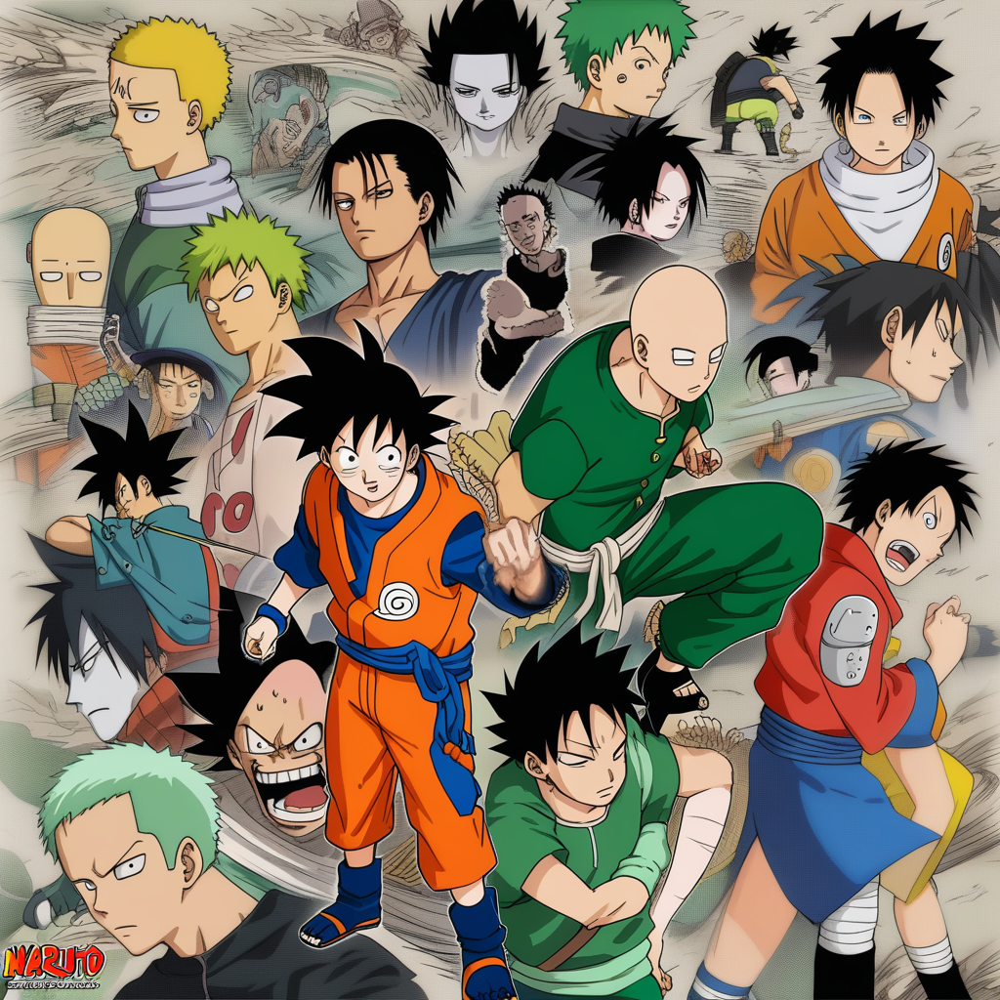

In [ ]:
replace_im = True

prmt = " war between anime characters , goku , luffy, zoro, naruto, sasuke, levi ackerman, saitama,masterpiece,badass,strong, cool"
img = "14.png"
if replace_im:
  diffusionPipe = DiffusionPipeline.from_pretrained(
    "cagliostrolab/animagine-xl-3.1",
    torch_dtype=torch.float16,
    use_safetensors=True,
).to("cuda")

  title_img =diffusionPipe(prompt=prmt).images[0]
  title_img.save(save_path+img)
  display(title_img)

In [ ]:
from diffusers import StableDiffusionPipeline
import torch


model_id = "dreamlike-art/dreamlike-photoreal-2.0"
diffusionPipe = StableDiffusionPipeline.from_pretrained(model_id, torch_dtype=torch.float16)
diffusionPipe = diffusionPipe.to("cuda")




title_img =diffusionPipe(prompt=title_image_prompt,height = 960, width = 544).images[0]
title_img.save(save_path+"1_0.png")

for i,response in enumerate(responses_image_prompts):
    print(response)
    response_img = diffusionPipe(prompt=response,height = 960,width = 544).images[0]

    response_img.save(save_path+"1_"+f"{i+1}.png")

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Anger, its fiery form wreathed in flames as it lashes out with searing fury, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Fear, its shadowy figure looming in the darkness as it whispers chilling nightmares into the minds of its victims, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Sadness, its tear-streaked face hidden beneath a veil of darkness as it envelops its prey in an abyss of despair, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Envy, its twisted form contorted with jealousy as it covets the successes and blessings of others, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Joy, its radiant aura shining bright as it fills the hearts of those around it with laughter and happiness, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Guilt, its haunting gaze piercing the soul as it torments its victims with remorse and regret, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Anxiety, its jittery movements and frenzied whispers driving its victims to the brink of madness, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Love, its tender embrace warming the hearts of those touched by its divine presence, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Pride, its regal posture and haughty demeanor betraying its arrogance and self-importance, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Hope, its steadfast resolve shining bright as it guides its followers through the darkest of times, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Regret, its mournful wails echoing through the void as it mourns the choices and opportunities lost to time, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

The demon of Curiosity, its insatiable hunger for knowledge driving it to unravel the mysteries of the universe, 8k, digital art


  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
del diffusionPipe
torch.cuda.empty_cache()


In [ ]:

diffusionPipe = DiffusionPipeline.from_pretrained(
    "cagliostrolab/animagine-xl-3.1",
    torch_dtype=torch.float16,
    use_safetensors=True,
).to("cuda")
title_img =diffusionPipe(prompt=title_image_prompt,height = 960, width = 544).images[0]
title_img.save(save_path+"0.png")

for i,response in enumerate(responses_image_prompts):
    print(response)
    response_img = diffusionPipe(prompt=response,height = 960,width = 544).images[0]

    response_img.save(save_path+f"{i+1}.png")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Goku (Dragon Ball),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Naruto Uzumaki (Naruto),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Monkey D. Luffy (One Piece),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Saitama (One Punch Man),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Ichigo Kurosaki (Bleach),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Spike Spiegel (Cowboy Bebop),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Edward Elric (Fullmetal Alchemist),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Light Yagami (Death Note),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Levi Ackerman (Attack on Titan),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Kagome Higurashi (Inuyasha),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Asuka Langley Soryu (Neon Genesis Evangelion),masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

Lelouch vi Britannia (Code Geass),masterpiece,badass,strong, coolwar between anime characters , goku , luffy, zoro, naruto, sasuke, levi ackerman, saitama,masterpiece,badass,strong, cool


  0%|          | 0/50 [00:00<?, ?it/s]

In [ ]:
del diffusionPipe

0_0.png


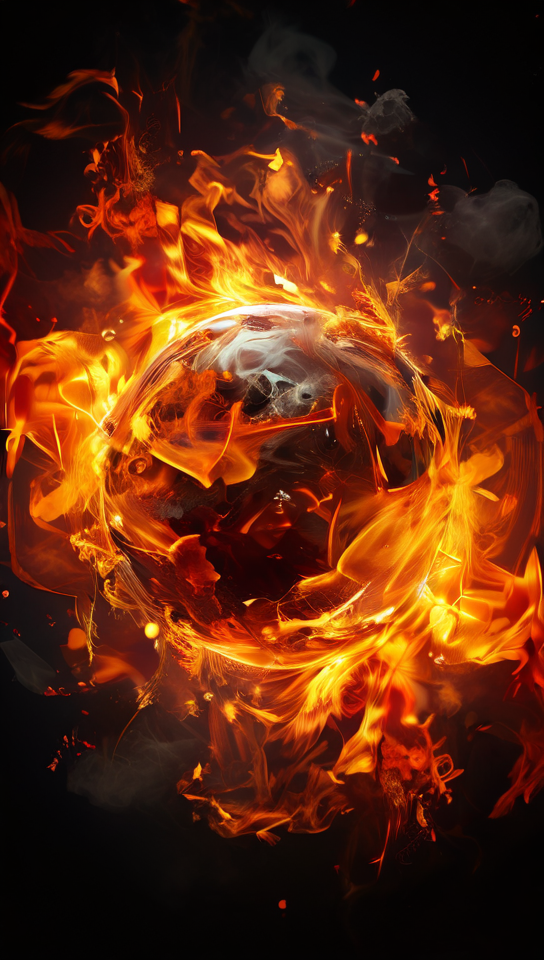

1_0.png


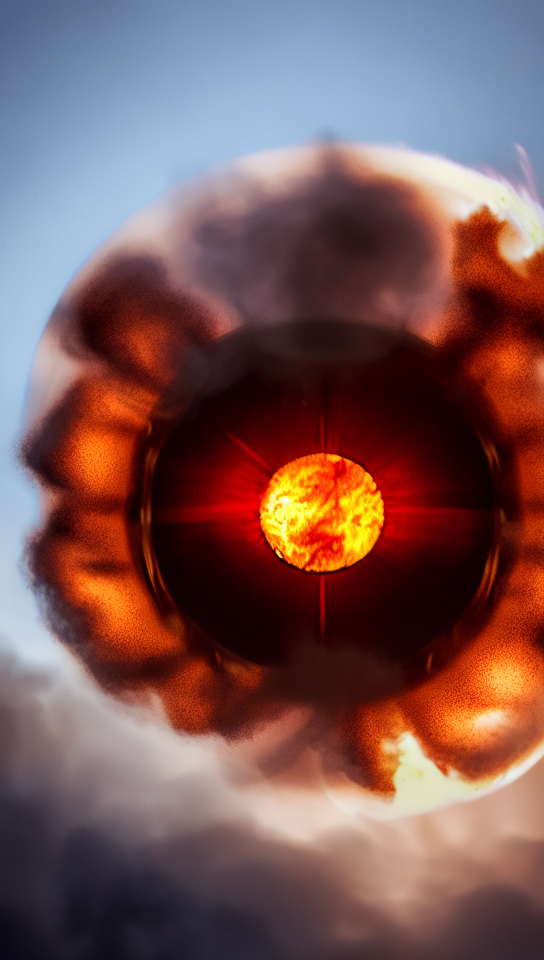

select between 1 and 21
0_1.png


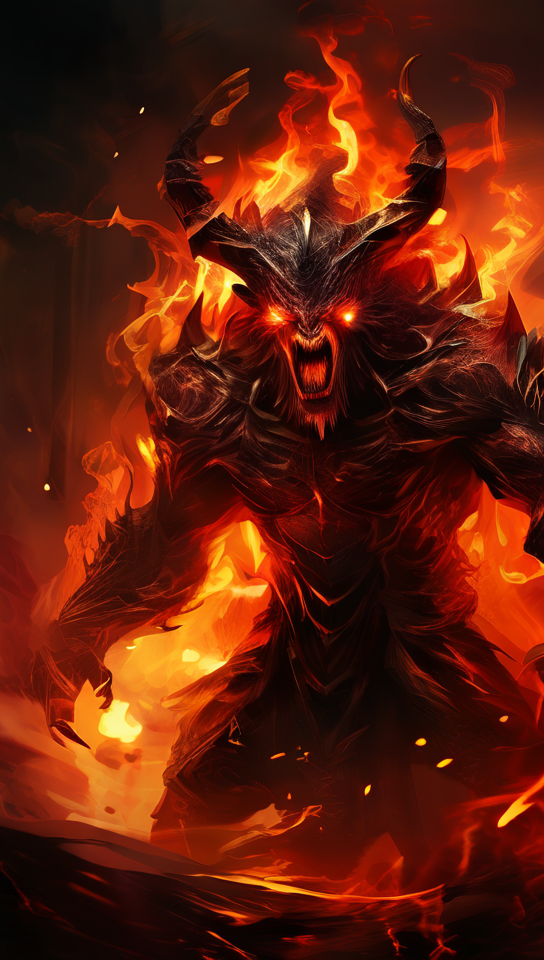

1_1.png


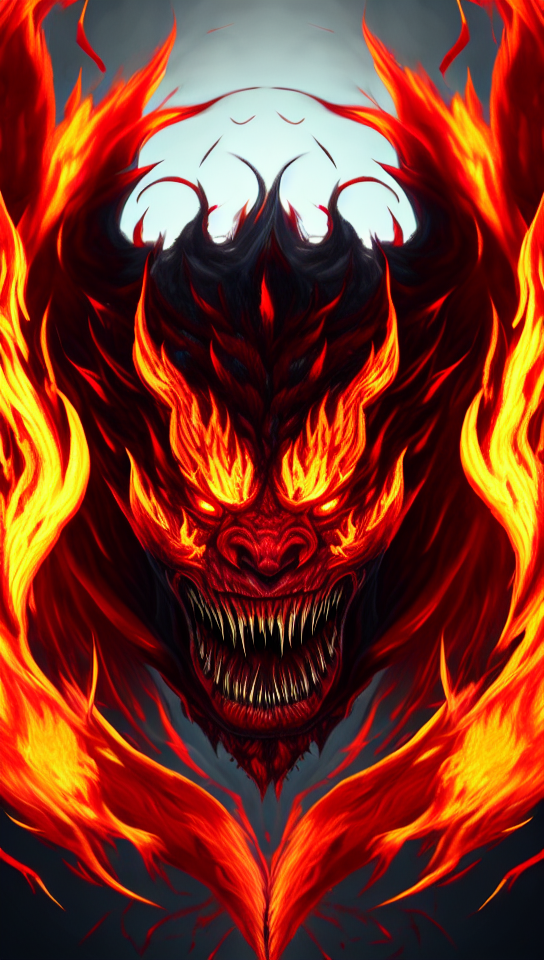

select between 1 and 22
0_2.png


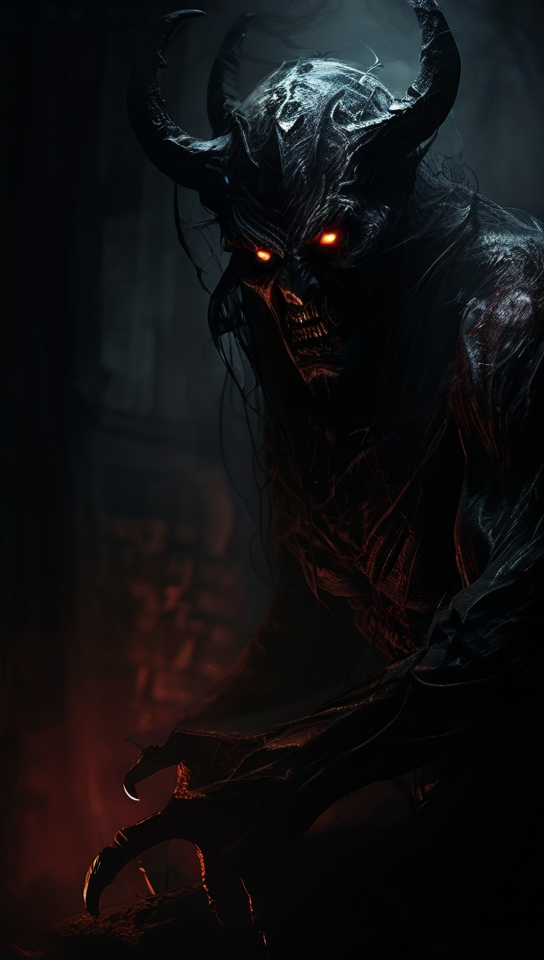

1_2.png


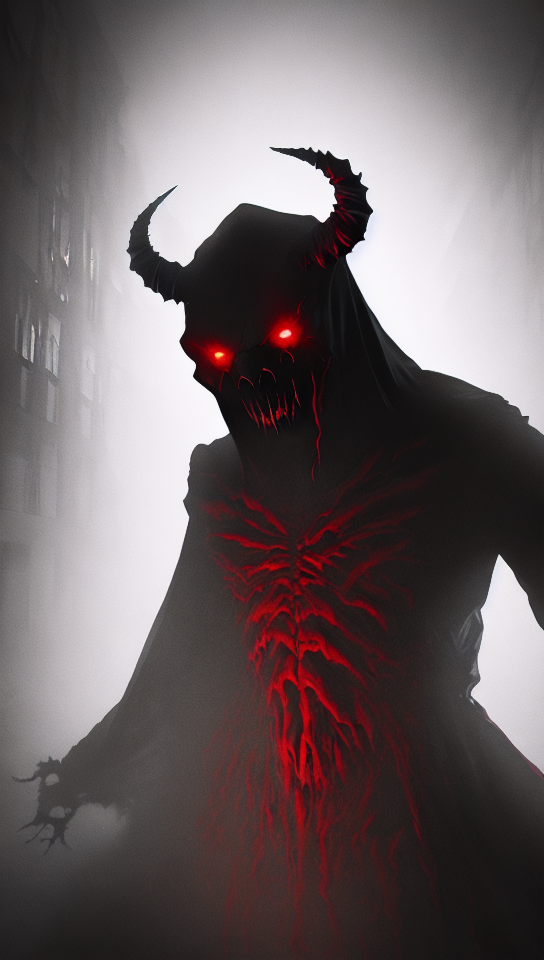

select between 1 and 21
0_3.png


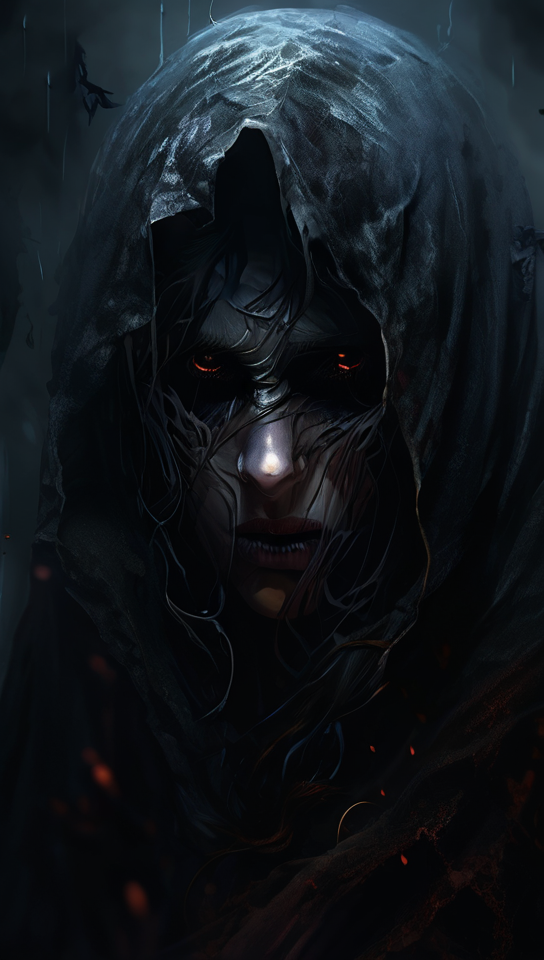

1_3.png


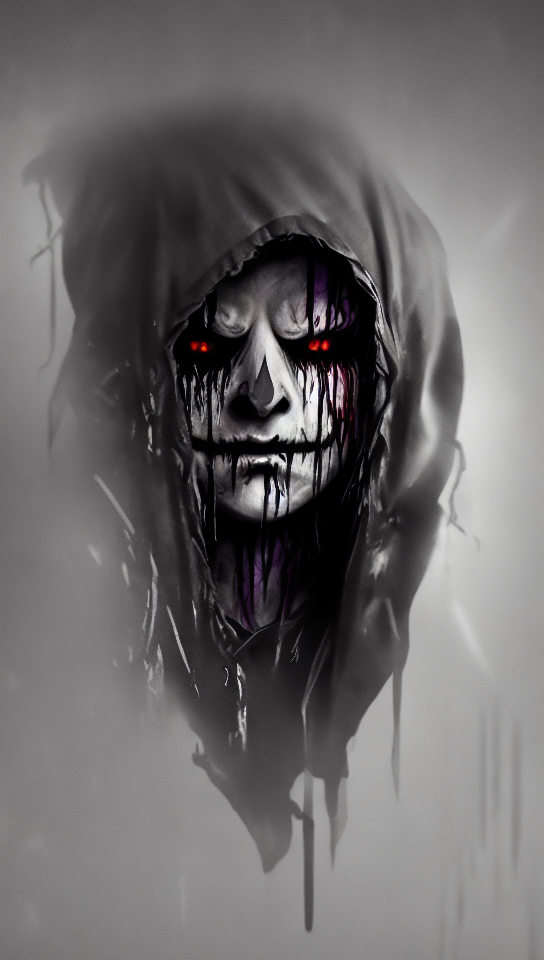

select between 1 and 21
0_4.png


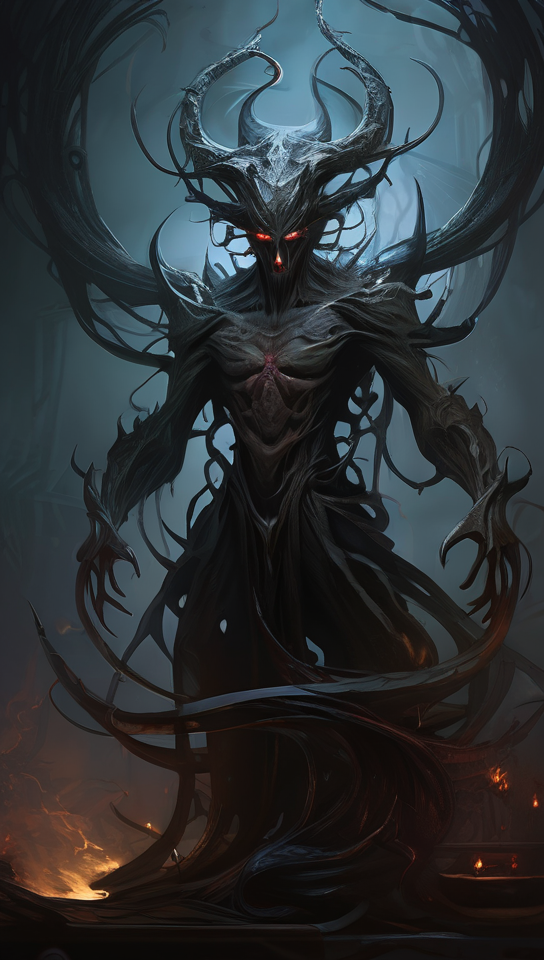

1_4.png


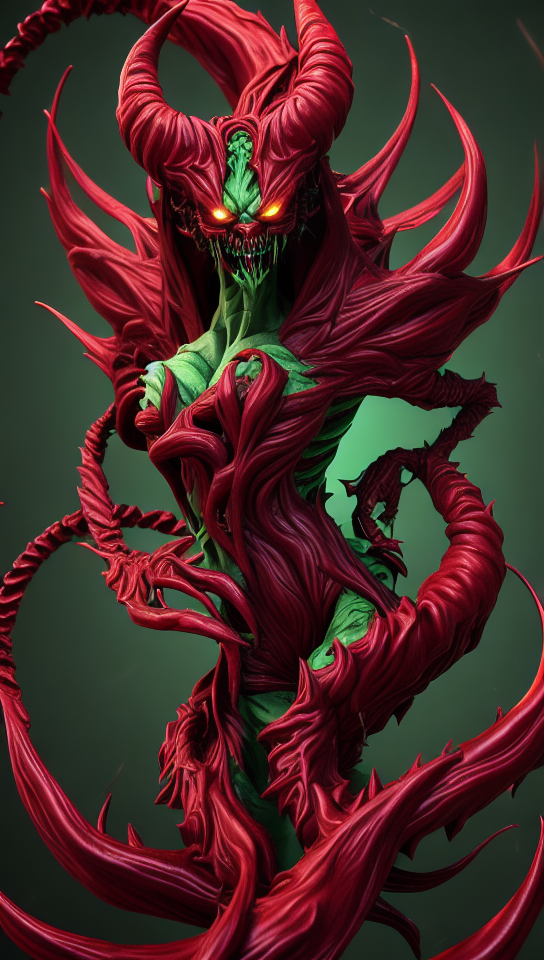

select between 1 and 22
0_5.png


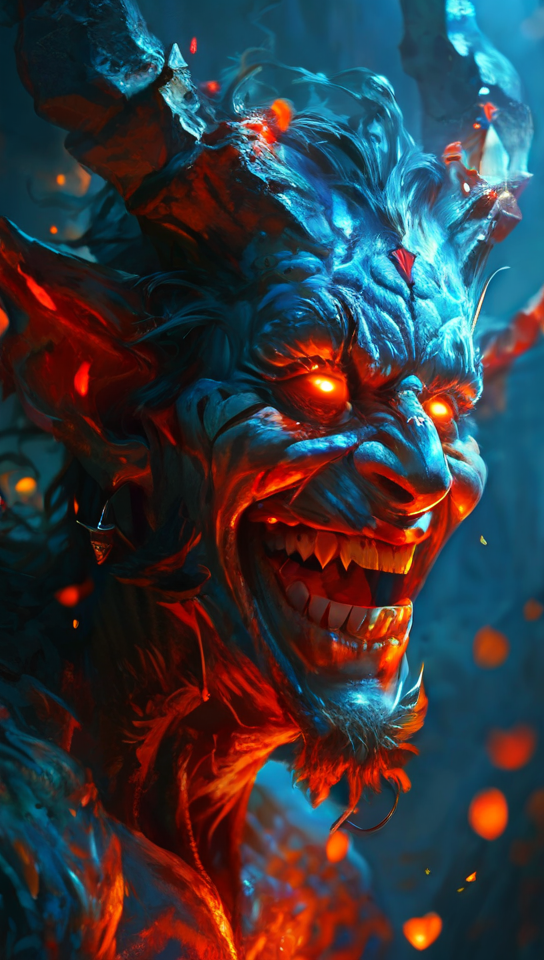

1_5.png


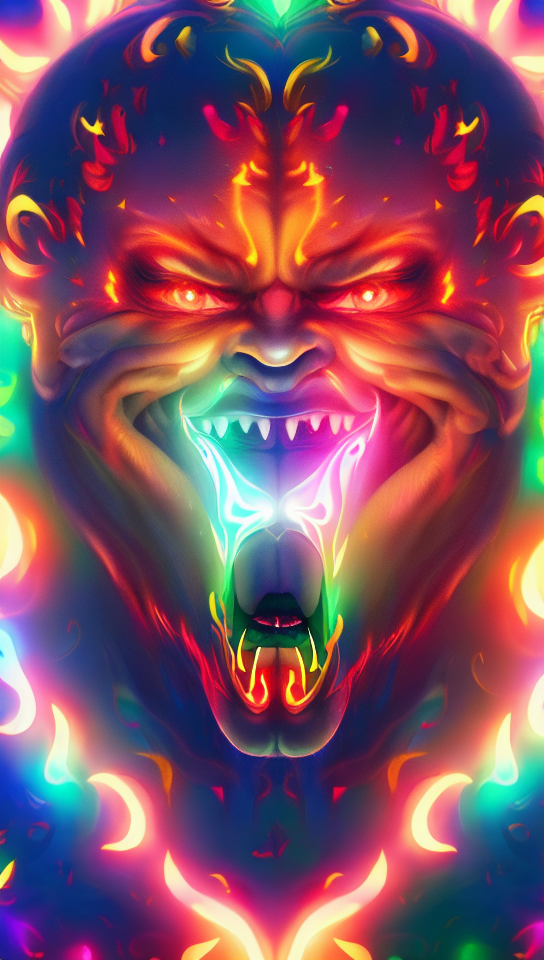

select between 1 and 21
0_6.png


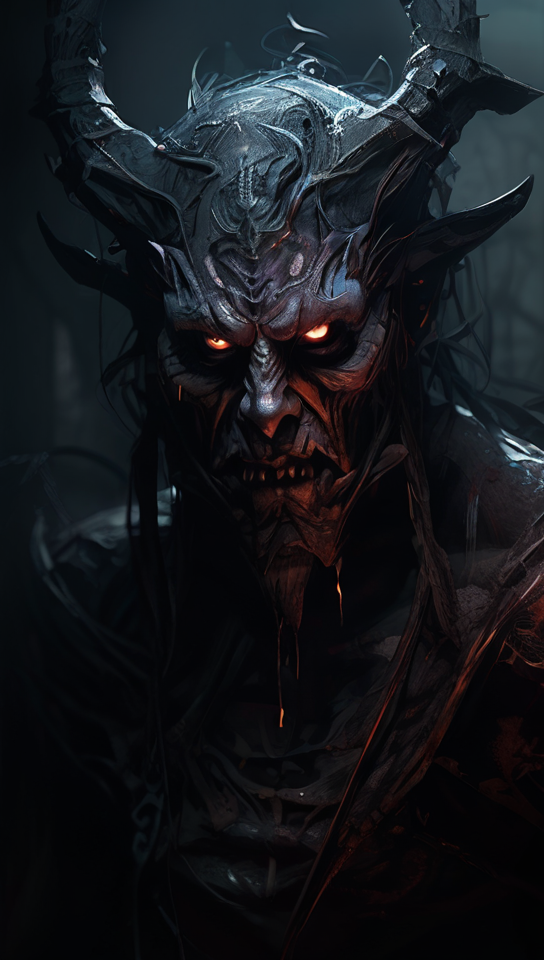

1_6.png


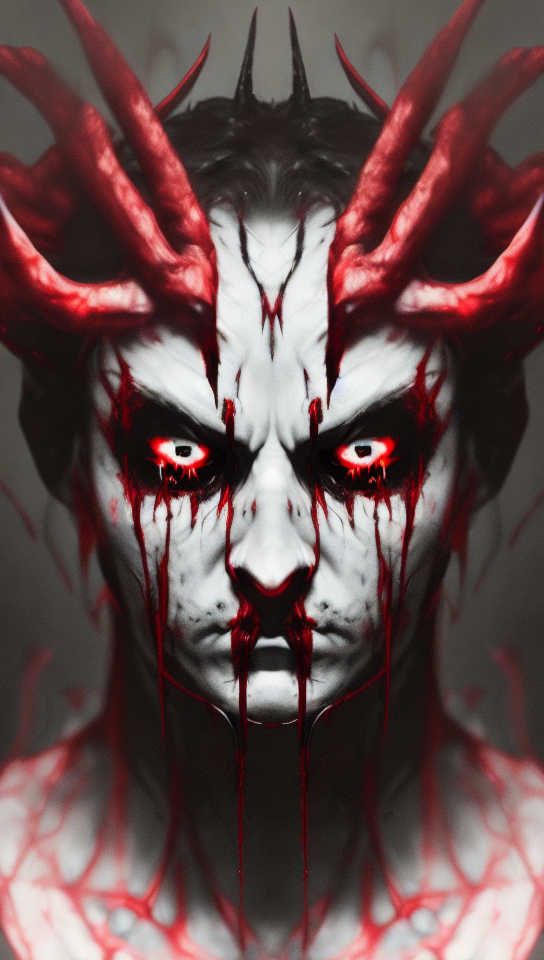

select between 1 and 22
0_7.png


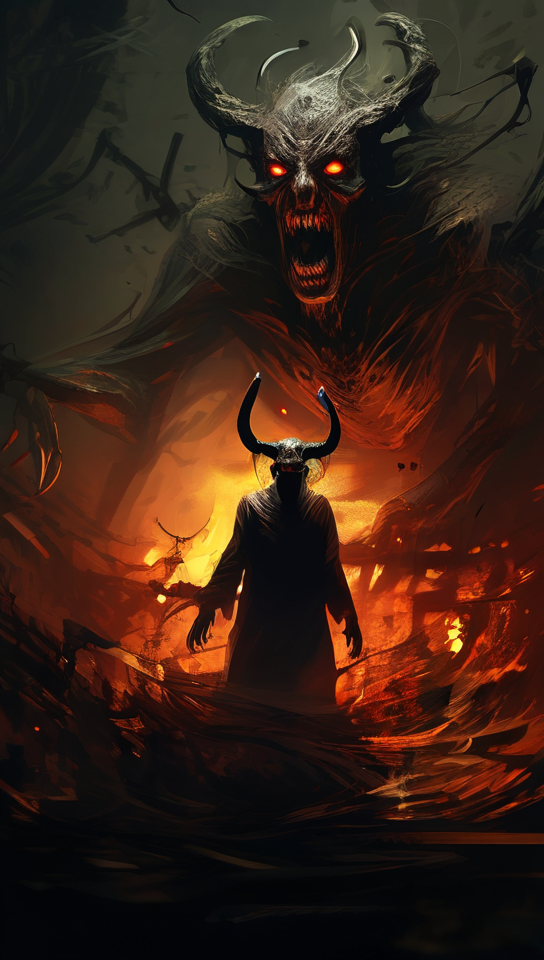

1_7.png


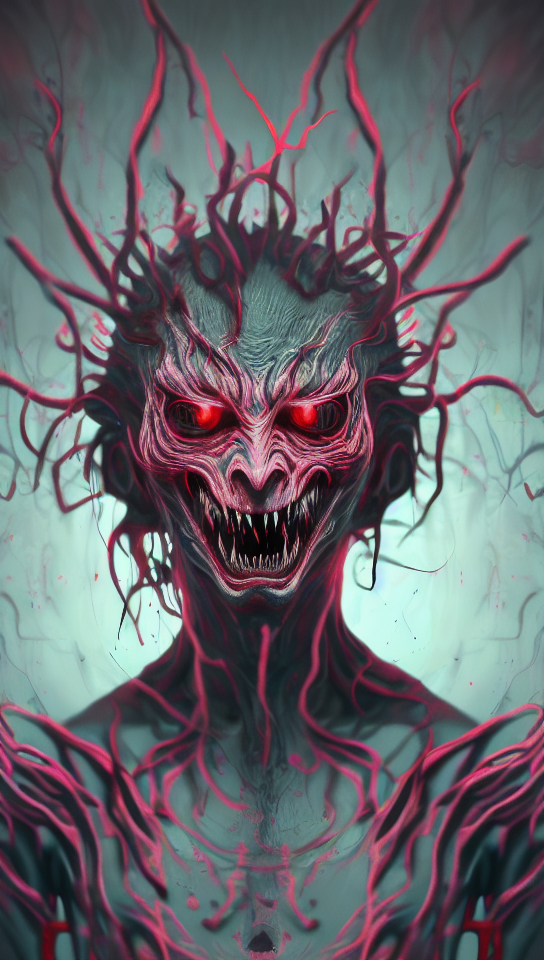

select between 1 and 22
0_8.png


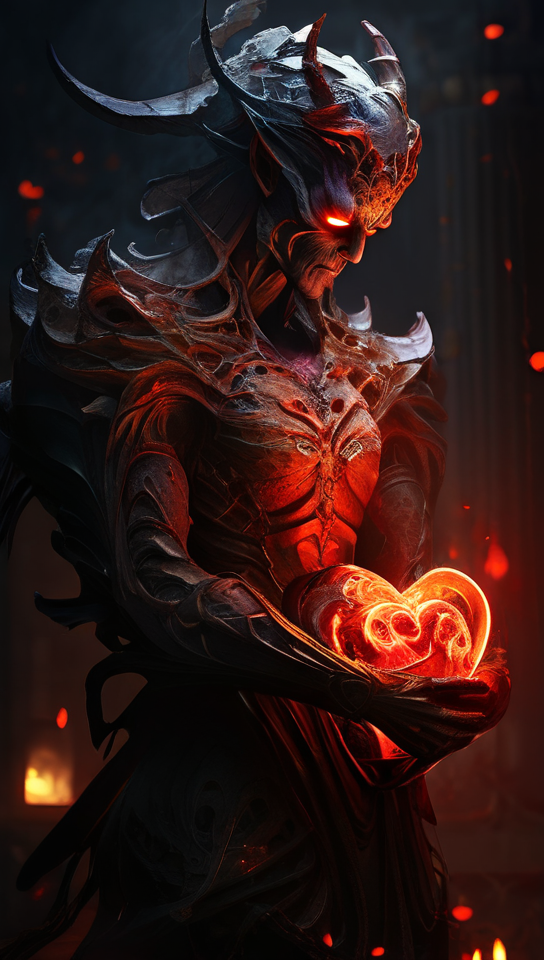

1_8.png


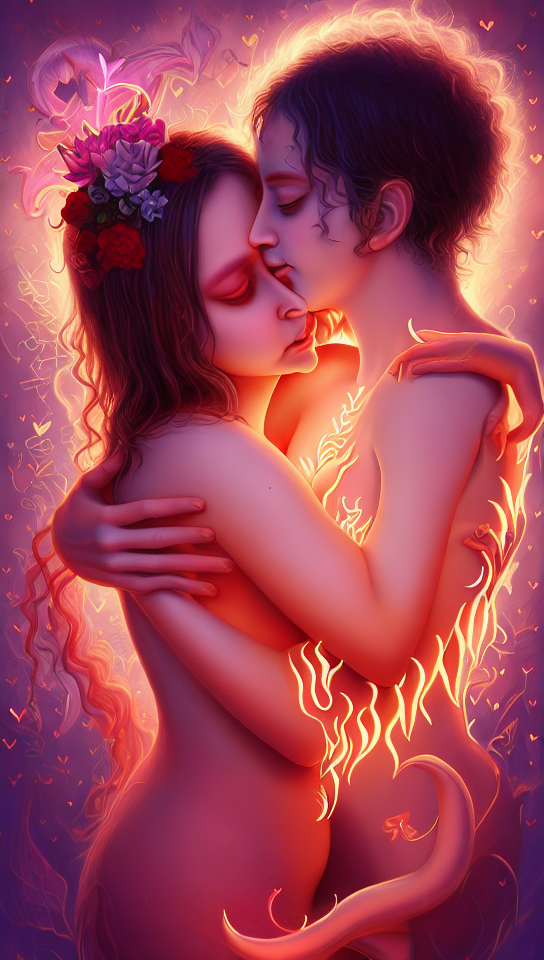

select between 1 and 21
0_9.png


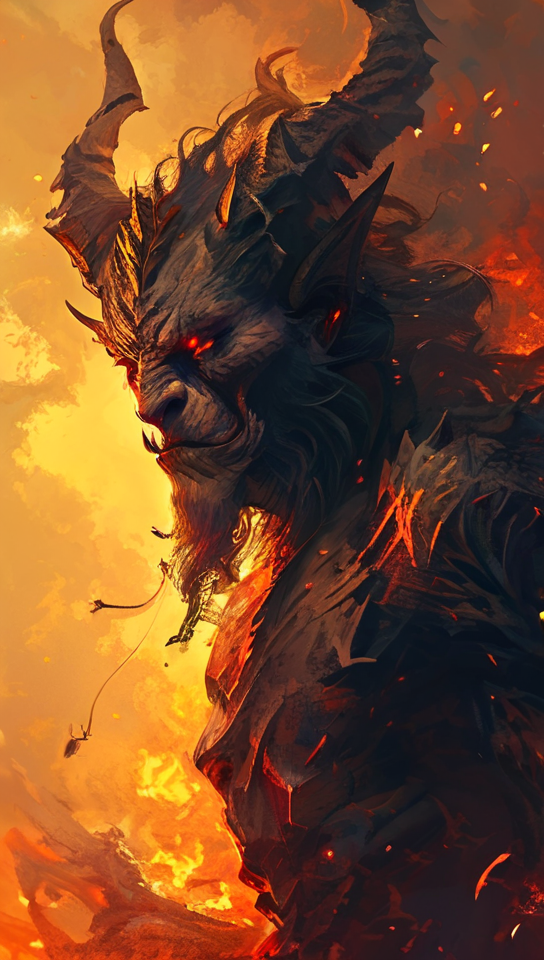

1_9.png


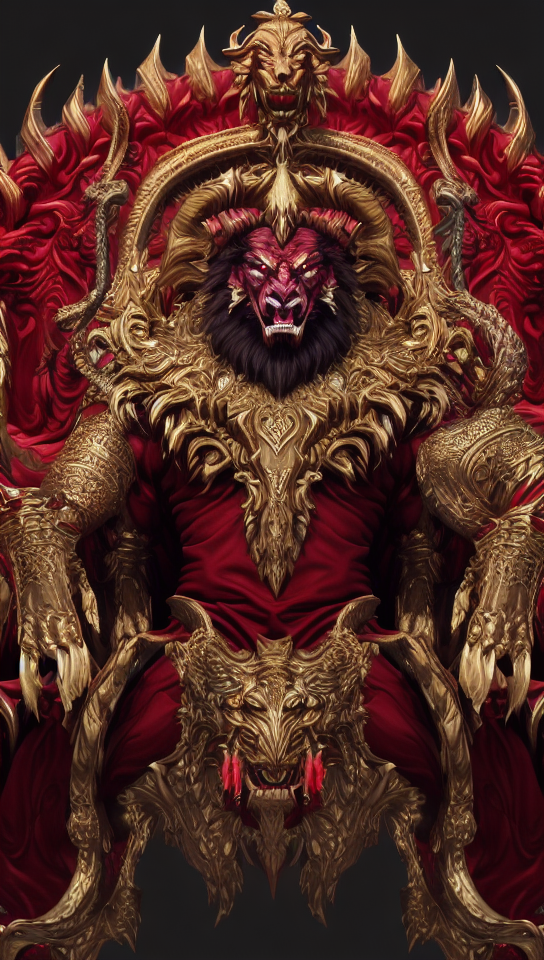

select between 1 and 22
0_10.png


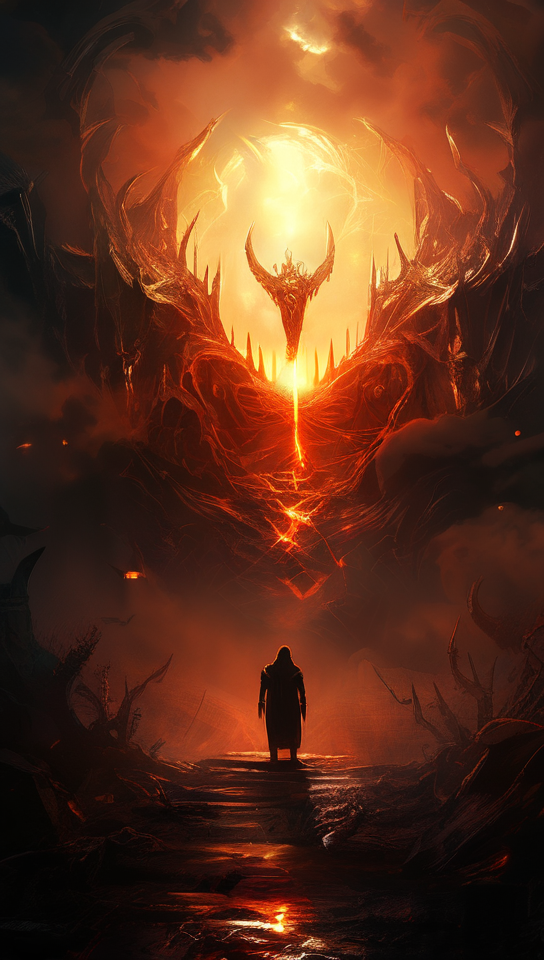

1_10.png


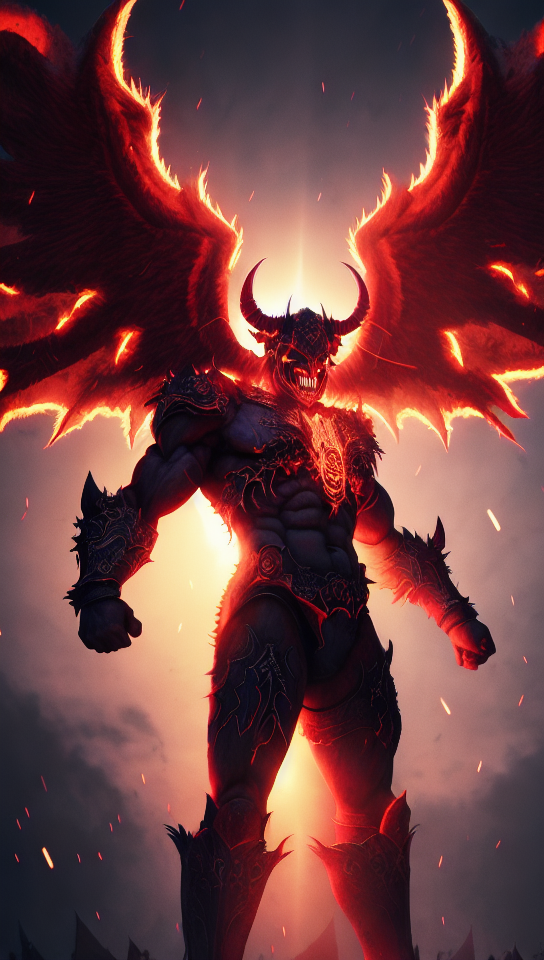

select between 1 and 21
0_11.png


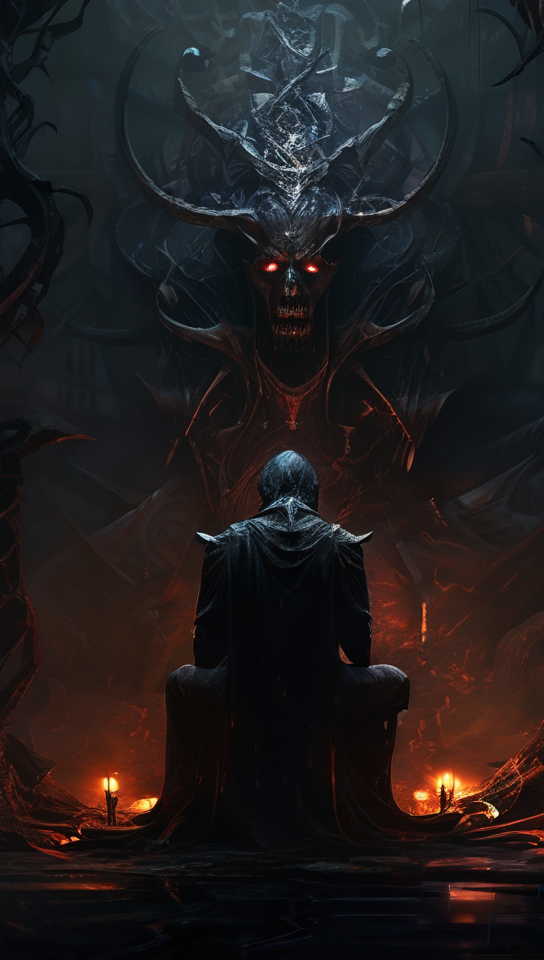

1_11.png


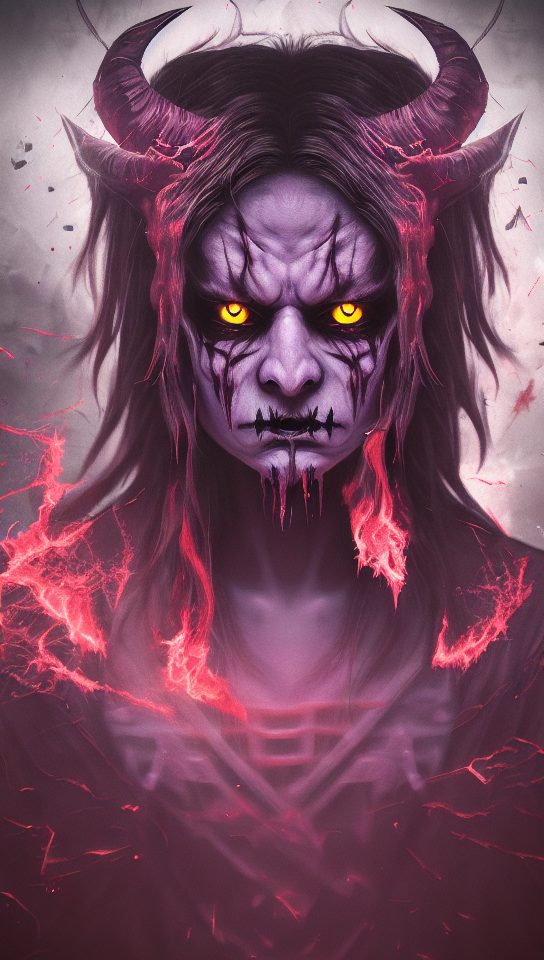

select between 1 and 21
0_12.png


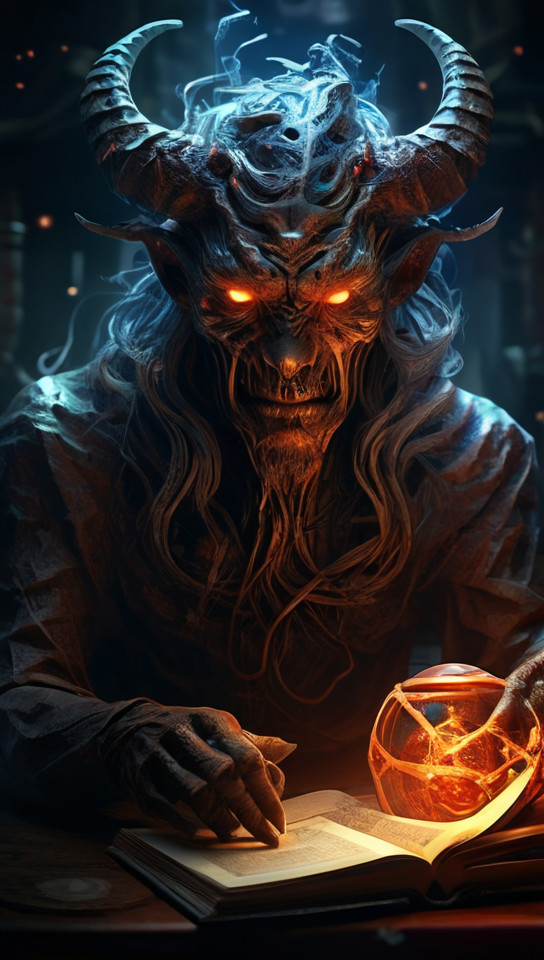

1_12.png


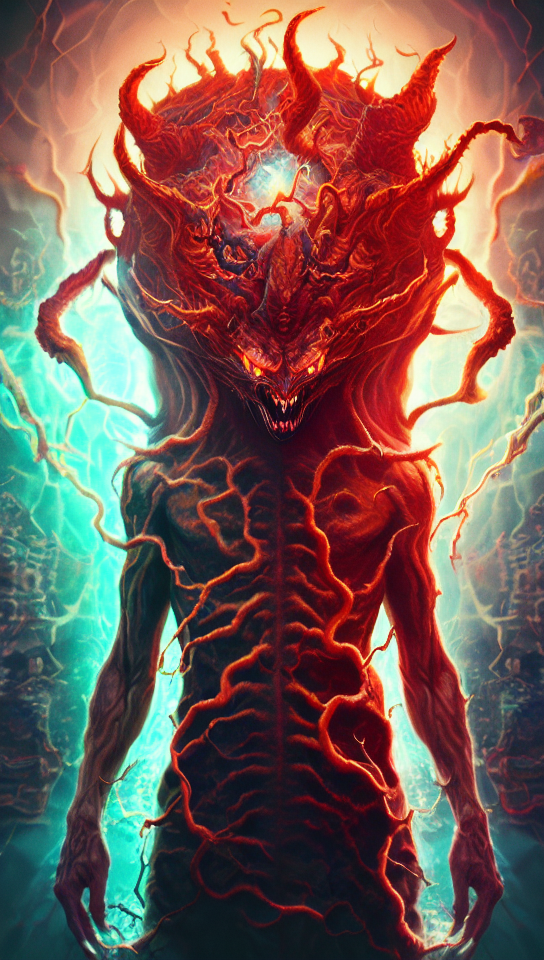

select between 1 and 22


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
import os
num_models = 2
for i in range(len(responses)+1):
  tims = []
  for x in range(num_models):
    print(f"{x}_{i}.png")
    im =cv2.imread(save_path+f"{x}_{i}.png")
    tims.append(im)
    cv2_imshow(im)
  ip  = int(input(f"select between 1 and {num_models}"))
  os.rename(save_path+f"{ip-1}_{i}.png",save_path+f"{i}.png")





In [ ]:
import cv2
import numpy as np


if responses[0] != video_title:
    responses.insert(0,video_title)

def align_text_to_image(text, image, font, font_scale, color, thickness, alignment = "Center",X_pos = None,Y_pos = None):
  if alignment == "Center":
    text_size, _ = cv2.getTextSize(text, font, font_scale, thickness)
    if X_pos == None:
      text_x = (image.shape[1] - text_size[0]) // 2
    if Y_pos == None:
      text_y = (image.shape[0] + text_size[1]) // 2
    else:
      text_y = Y_pos

    cv2.putText(image, text, (text_x, text_y), font, font_scale, color, thickness)

def add_text_to_image(image, text, position=(330, 800), font=cv2.FONT_HERSHEY_COMPLEX, font_scale=3, color=(255, 255, 255), thickness=5):
  cv2.putText(image, text, position, font, font_scale, color, thickness)

def calculate_fps(text,vid_length):
  frames = len(text.split(" "))
  fps = frames / vid_length
  return fps

def textOnImg_vid(text,img,name="gg",frame_shape = None,title=None,title_align = "Center",font = cv2.FONT_HERSHEY_COMPLEX,vid_len=None,audio=None,fps=None,font_scale = 3):

  video_name = f'{name}.mp4'
  if fps == None:
    if vid_len ==None:
      fps=24
    else:
      fps = calculate_fps(text,vid_len)
  frame = img
  if frame_shape == None:
    frame_shape = frame.shape
  height, width, layers = frame_shape
  img = cv2.resize(img, (width, height))


  if title !=None:
    if title_align == "Center":
      textsize = cv2.getTextSize(title, font, 1, 2)[0]
      textX = (width - textsize[0]) / 2
      textY = 150
      cv2.putText(img, title, (int(textX), int(textY)), font, 1, (0, 0, 0), 8)
      cv2.putText(img, title, (int(textX), int(textY)), font, 1, (255, 255, 255), 2)

  color = (255, 255, 255)
  thickness = 2
  font = cv2.FONT_HERSHEY_COMPLEX

  #video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))


  if cv2.getTextSize(text, font, font_scale, thickness)[0][0] > width:
    words = text.split()
    lines = []
    current_line = words[0] + " "  # Start with the first word
    for word in words[1:]:
      test_line = current_line + word + " "
      test_size, _ = cv2.getTextSize(test_line, font, font_scale, thickness)
      if test_size[0] > width:
        lines.append(current_line)
        current_line = word + " "
      else:
        current_line = test_line
        # Add the last line
    lines.append(current_line)
    yp = 900
    c=0
    for line in lines:


      align_text_to_image(line, img, font, font_scale, (0,0,0), thickness*3, alignment = "Center",X_pos = None,Y_pos = yp+c*100)
      align_text_to_image(line, img, font, font_scale, color, thickness, alignment = "Center",X_pos = None,Y_pos = yp+c*100)
      c+=1
  else:
    align_text_to_image(text, img, font, font_scale, (0,0,0), thickness*3, alignment = "Center",X_pos = None,Y_pos = None)
    align_text_to_image(text, img, font, font_scale, color, thickness, alignment = "Center",X_pos = None,Y_pos = None)




  # fps = tot_frames / vid_length
  # print("TOTAL FRAMES : ",tot_frames)
  # print("FPS : ",fps)
  # print("VIDEO LENGTH : ",vid_length)
  video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))
  video.write(img)

  # Release the video writer
  video.release()
  cv2.destroyAllWindows()
  video1 = mp.VideoFileClip(video_name)
  if audio != None:
    video1 = video1.set_audio(audio)
  video1.write_videofile(f"{name}_final.mp4")



#textOnImg_vid(text,img,title="Why does it feel so good to scratch an itch?",title_align="Center",frame_shape=(1920,1080,3))
final_video = []
for i in range(len(responses)):
  import moviepy.editor as mp
  #audio = mp.AudioFileClip(f"{i}.wav")
  #vid_length = audio.duration
  img = cv2.imread(f"{i}.png")
  textOnImg_vid(responses[i],img,name=f"{i}",title=responses[0],title_align="Center",frame_shape=(1920,1080,3),fps=1)
  final_video.append(mp.VideoFileClip(f"{i}_final.mp4"))

final_video = mp.concatenate_videoclips(final_video)
music = None
if music != None:
  final_video = final_video.set_audio(mp.AudioFileClip(music).set_duration(final_video.duration))
final_video.write_videofile("final_video.mp4")

Moviepy - Building video 0_final.mp4.
Moviepy - Writing video 0_final.mp4



Moviepy - Done !
Moviepy - video ready 0_final.mp4


Moviepy - Building video 1_final.mp4.
Moviepy - Writing video 1_final.mp4



Moviepy - Done !
Moviepy - video ready 1_final.mp4


Moviepy - Building video 2_final.mp4.
Moviepy - Writing video 2_final.mp4



Moviepy - Done !
Moviepy - video ready 2_final.mp4


Moviepy - Building video 3_final.mp4.
Moviepy - Writing video 3_final.mp4



Moviepy - Done !
Moviepy - video ready 3_final.mp4


Moviepy - Building video 4_final.mp4.
Moviepy - Writing video 4_final.mp4



Moviepy - Done !
Moviepy - video ready 4_final.mp4


Moviepy - Building video 5_final.mp4.
Moviepy - Writing video 5_final.mp4



Moviepy - Done !
Moviepy - video ready 5_final.mp4


Moviepy - Building video 6_final.mp4.
Moviepy - Writing video 6_final.mp4



Moviepy - Done !
Moviepy - video ready 6_final.mp4


Moviepy - Building video 7_final.mp4.
Moviepy - Writing video 7_final.mp4



Moviepy - Done !
Moviepy - video ready 7_final.mp4


Moviepy - Building video 8_final.mp4.
Moviepy - Writing video 8_final.mp4



Moviepy - Done !
Moviepy - video ready 8_final.mp4


Moviepy - Building video 9_final.mp4.
Moviepy - Writing video 9_final.mp4



Moviepy - Done !
Moviepy - video ready 9_final.mp4


Moviepy - Building video 10_final.mp4.
Moviepy - Writing video 10_final.mp4



Moviepy - Done !
Moviepy - video ready 10_final.mp4


Moviepy - Building video 11_final.mp4.
Moviepy - Writing video 11_final.mp4



Moviepy - Done !
Moviepy - video ready 11_final.mp4


Moviepy - Building video 12_final.mp4.
Moviepy - Writing video 12_final.mp4



Moviepy - Done !
Moviepy - video ready 12_final.mp4


Moviepy - Building video 13_final.mp4.
Moviepy - Writing video 13_final.mp4



Moviepy - Done !
Moviepy - video ready 13_final.mp4


Moviepy - Building video 14_final.mp4.
Moviepy - Writing video 14_final.mp4



Moviepy - Done !
Moviepy - video ready 14_final.mp4


Moviepy - Building video final_video.mp4.
Moviepy - Writing video final_video.mp4



Moviepy - Done !
Moviepy - video ready final_video.mp4
